<a href="https://colab.research.google.com/github/htdung167/Face-Mask-Detection/blob/main/Code/RetinaNet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**I. Mount Drive**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd /content/drive/MyDrive/CS117/RetinaNet

/content/drive/MyDrive/CS117/RetinaNet


#**II. Install Detectron2**

In [ ]:
!pip install pyyaml==5.1
# workaround: install old version of pytorch since detectron2 hasn't released packages for pytorch 1.9 (issue: https://github.com/facebookresearch/detectron2/issues/3158)
!pip install torch==1.8.0+cu101 torchvision==0.9.0+cu101 -f https://download.pytorch.org/whl/torch_stable.html

# install detectron2 that matches pytorch 1.8
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.8/index.html
#exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

     |████████████████████████████████| 274 kB 7.3 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44092 sha256=86757548bdd33a195820147628c8dc7d334031a4963739a684e7af5de6df7185
  Stored in directory: /root/.cache/pip/wheels/77/f5/10/d00a2bd30928b972790053b5de0c703ca87324f3fead0f2fd9
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |████████████████████████████████| 763.5 MB 15 kB/s 
     |████████████████████████████████| 17.3 MB 173 kB/s 
  Attempting uninstall: torch
    Found existing installation: torch 1.9.0+cu102
    Uninstalling torch-1.9.0+cu102:
      Successfully uninstalled torch-1.9.0+cu102
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.10.0+cu102
    Uninstalling torchvision-0.10.0+cu102:
      Successf

#**II. Import**

In [ ]:
%cd /content/drive/MyDrive/CS117/RetinaNet

/content/drive/MyDrive/CS117/RetinaNet


In [ ]:
# Kiểm tra cài đặt pytorch, nếu lỗi chạy lại từ đầu 
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
assert torch.__version__.startswith("1.8")   

1.8.0+cu101 True


In [ ]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()
import numpy as np
import os, json, cv2, random, glob
from google.colab.patches import cv2_imshow
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.config import config as cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
from detectron2.structures import BoxMode
from detectron2.data.datasets import register_coco_instances

#**III. Convert Data: Yolo (txt)-> Coco (json)**

##**1. Download and Unzip Data**

##**2. Convert Function**

In [ ]:
# def get_data_dicts(label_dir, image_dir):
#     anno_files = [f for f in os.listdir(label_dir) if f.endswith('.txt')]
#     classes = ["0"]
#     dataset_dicts = []
#     count = 0

#     for image_id, file_name in enumerate(anno_files):
#         record = {}
#         print(file_name)
#         try:
#             image_path = os.path.join(image_dir, file_name.rstrip('txt') + 'jpg')
#             print("access {} file".format(image_path))
#             height, width = cv2.imread(image_path).shape[:2]
#             count += 1
#             record["file_name"] = image_path
#             record["image_id"] = image_id 
#             record["height"] = height
#             record["width"] = width

#             annotations = open(os.path.join(label_dir, file_name), 'r')
#             objs = []
#             for line in annotations:
#                 line = line.rstrip('\n')
#                 class_id, x_center, y_center, w, h = line.split()[:]
            
#                 w = float(w)
#                 h = float(h)
#                 w = int(w * width)
#                 h = int(h * height)

#                 x_center = float(x_center)
#                 y_center = float(y_center)

#                 x_center = int(x_center * width)
#                 y_center = int(y_center * height)
#                 x_min = int(x_center - w/2)
#                 y_min = int(y_center - h/2)
#                 x_max = int(x_center + w/2)
#                 y_max = int(y_center + h/2)
#                 obj = {
#                     'bbox' : [x_min, y_min, x_max, y_max],
#                     'bbox_mode' : BoxMode.XYXY_ABS,
#                     'category_id' : int(class_id),
#                     'iscrowd' : 0
#                 }
#                 objs.append(obj)
#             record["annotations"] = objs
#             dataset_dicts.append(record)
#         except:
#             print('can not read file')
#             pass
    
#     return dataset_dicts

In [ ]:
import numpy as np
import os, json, cv2, random, glob

In [ ]:
def get_data_dicts(originLabelsDir, originImagesDir, classes_dir):  
    txtFileList = [f for f in os.listdir(originLabelsDir) if f.endswith('.txt')]
    record = []
    for txtFile in txtFileList:
        print(txtFile)
        try:
            with open(os.path.join(originLabelsDir, txtFile), 'r') as fr:
                labelList = fr.readlines()
                for label in labelList:
                    label = label.strip().split()
                    x = float(label[1])
                    y = float(label[2])
                    w = float(label[3])
                    h = float(label[4])

                    # convert x,y,w,h to x1,y1,x2,y2
                    imgFile = [f for f in os.listdir(originImagesDir) if (f.startswith(txtFile[:-4]) and not f.endswith('.txt'))][0]
                    imagePath = os.path.join(originImagesDir, imgFile)
                    image = cv2.imread(imagePath)
                    H, W, _ = image.shape
                    x1 = (x - w / 2) * W
                    y1 = (y - h / 2) * H
                    x2 = (x + w / 2) * W
                    y2 = (y + h / 2) * H
                    # In order to match the coco label method, the label serial number is calculated from 1
                    # imgFile = [f for f in os.listdir(originImagesDir) if (f.startswith(txtFile[:-4]) and not f.endswith('.txt'))][0]
                    record.append(imgFile + ' {} {} {} {} {}\n'.format(int(label[0]) + 1, x1, y1, x2, y2))
        except:
            print("                  can not read file")
            pass
 ##########################           
        
    # dataset is used to save image information and annotation information of all data
    dataset = {'categories': [], 'annotations': [], 'images': []}
    
    # Open category label
    with open(classes_dir) as f:
        classes = f.read().strip().split()
    
    # Establish the correspondence between category labels and numeric ids

    for i, cls in enumerate(classes, 1):
        dataset['categories'].append({'id': i-1, 'name': cls, 'supercategory': 'mark'})
    
    # Read the image name of the images folder
    indexes = [f for f in os.listdir(originImagesDir) if not f.endswith('.txt')]
    
    # Read Bbox information
    for k, index in enumerate(indexes):
        print("2_" + index)
        im = cv2.imread(originImagesDir + '/' + index)
        height, width, _ = im.shape

        # Add image information to the dataset
        dataset['images'].append({'file_name': index,
                                  'id': k,
                                  'width': width,
                                  'height': height})

        for ii, anno in enumerate(record):
            parts = anno.strip().split()

            # Add a tag if the name of the image and the name of the tag are on
            if parts[0] == index:
                                  # 
                cls_id = parts[1]
                # x_min
                x1 = float(parts[2])
                # y_min
                y1 = float(parts[3])
                # x_max
                x2 = float(parts[4])
                # y_max
                y2 = float(parts[5])
                width = max(0, x2 - x1)
                height = max(0, y2 - y1)
                dataset['annotations'].append({
                    'area': width * height,
                    'bbox': [x1, y1, width, height],
                    'category_id': int(cls_id) - 1,
                    'id': ii,
                    'image_id': k,
                    'iscrowd': 0,
                    'segmentation': [[x1, y1, x2, y1, x2, y2, x1, y2]]
                })
    return dataset

##**3. Create file json**

In [ ]:
%cd /content/drive/MyDrive/CS117/RetinaNet

/content/drive/MyDrive/CS117/RetinaNet


In [ ]:
train_dicts = get_data_dicts('/content/drive/MyDrive/CS117/Yolo/darknet/data/data/train','/content/drive/MyDrive/CS117/Yolo/darknet/data/data/train', '/content/drive/MyDrive/CS117/Yolo/darknet/data/data/classes.txt')

20200204102034251866.txt
15nyvirus-masks01-mediumSquareAt3X.txt
190327-05_1024.txt
2020012913501217696.txt
1580286580_5bab.txt
20200206132618-c9fcbba8.txt
18s50010p60n147o750p.txt
464019010.txt
37e47040-dfbb-4f64-a1f5-2fc28920d660.txt
304193_medium.txt
521315.txt
20pcs-Fashion-Mouth-Mask-Activated-Carbon-Cotton-Mask-Windproof-Anti-Dust-Men-and-woman-Mask-Health.txt
544097.txt
20200215165608560.txt
23692138-0-image-a-22_1579631872401.txt
2_WORLD_Coronavirus_083975.txt
4673875.txt
3p7r00027por8p8q10qp.txt
3FED248000000578-0-image-a-13_1493884143646.txt
46db30ff1d5a845cbe4e481ccc2626cd-149819.txt
420x0.txt
284423_1453686934636.txt
22823972-0-image-a-21_1577762638158.txt
4420x3000_614437672978.txt
3FED259000000578-4472558-Dangerous_People_in_northern_China_were_seen_wearing_masks_and_c-a-2_1493888420858.txt
3056453_1_1.txt
3p7p0002870p18p3sqq3.txt
4C71DB05-F1A9-481F-A8CC-FC31AFAFBC6D_w1071_s.txt
23012020_VirusMacau(cover)_AFP.txt
530083.txt
2DAF248F00000578-3285767-In_each_clip_the_mean_gi

In [ ]:
with open('train_dicts.json', 'w') as fp1:
    json.dump(train_dicts, fp1)

In [ ]:
val_dicts = get_data_dicts('/content/drive/MyDrive/CS117/Yolo/darknet/data/data/valid','/content/drive/MyDrive/CS117/Yolo/darknet/data/data/valid', '/content/drive/MyDrive/CS117/Yolo/darknet/data/data/classes.txt')

images30.txt
mark3-1024x607.txt
images285.txt
kGf6-hnvukfe8013164.txt
kljlhk.txt
images25.txt
mask02_1140x855.txt
images281.txt
images284.txt
mao-virus-900x540.txt
images73.txt
images98.txt
images29.txt
LondonChineseny260120-3.txt
in-swine_flu_school.txt
LQhzVZl.txt
kolkata1.txt
images23.txt
img-1580446267-73019900.txt
jlkkk.txt
images295.txt
images31.txt
images44.txt
kolkata2.txt
images97.txt
images38.txt
images40.txt
LYNXMPEG102IV_L.txt
istockphoto-609942644-170667a.txt
NINTCHDBPICT000558929314-1.txt
Model-with-White-face-mask-with-red-X-2.txt
images72.txt
istockphoto-609943198-1024x1024.txt
khvhkk.txt
images71.txt
KZJIS15WO6Beubo2G8EBQJpKpzIwOojzKyF02yshdNs.txt
madame_1.txt
maxresdefault (2).txt
maxresdefault (1).txt
jordan.txt
Nose_exposed_N95_grande.txt
images22.txt
iStock-998848022_1024.txt
images34.txt
merlin_167450115_211c72f4-b732-4b8f-aac3-de17afbab5cc-superJumbo.txt
NINTCHDBPICT000556650347-1.txt
los-angeles-airport-passengers-masks-coronavirus.txt
medicom_50_1578883042_4270

In [ ]:
with open('val_dicts.json', 'w') as fp2:
    json.dump(val_dicts, fp2)

In [ ]:
test_dicts = get_data_dicts('/content/drive/MyDrive/CS117/Yolo/darknet/data/data/test','/content/drive/MyDrive/CS117/Yolo/darknet/data/data/test', '/content/drive/MyDrive/CS117/Yolo/darknet/data/data/classes.txt')

OIP7vZHgEGheRWy-R6I19P3TQHaE8.txt
NUZZHAB7IMI6VHQQW44IVOMBHU.txt
PHOTriZgIKIgsnNLdBJG75vj200203_1000x2000.txt
P0000100005637_3_37742.txt
PA-49784209-1024x684.txt
Persone.txt
Pakistan-China-coronavirus-92news.txt
PRI_129079114_1580299603.195.txt
r1000019q689461s9r0.txt
sdfsdfsfff.txt
phpM5suKS.txt
photo_l.txt
pollution-mask-CE5HYF.txt
shutterstock_1627199179.txt
TB2R28UvUOWBKNjSZKzXXXfWFXa_!!1116877752.txt
r1000019q669394n9qp.txt
ST_20170401_EASAND_3046471.txt
RTX1GIDS.txt
people-waiting-at-a-bus-stop-marrakech-morocco-africa-CPPBR8.txt
p61000068153229q475.txt
Smog-Mask-PM2-5-Carbon-Filter-Face-Masks-Fog-Dust-Air-Cleaner-anti-pollution-Face-Protector.txt
TELEMMGLPICT000222274435_trans_NvBQzQNjv4BqpVlberWd9EgFPZtcLiMQfyf2A9a6I9YchsjMeADBa08.txt
r1000019q679o5611r7.txt
pb-140116-chinasmog-01_f0be38db4f1769172f4a0fa2e888d565.fit-2000w.txt
sars-gettyimages-157005245.txt
photo (3).txt
Surgical-Mask-Effectiveness.txt
RZXE24HFK5GSVKVSN57VCVPQ4M.txt
people-standing-at-bus-stop-waiting-A8K95K.tx

In [ ]:
with open('test_dicts.json', 'w') as fp3:
    json.dump(test_dicts, fp3)

##**4. Read file json**

In [ ]:
register_coco_instances("my_dataset_train", {}, "/content/drive/MyDrive/CS117/RetinaNet/train_dicts.json", "/content/drive/MyDrive/CS117/Yolo/darknet/data/data/train")
register_coco_instances("my_dataset_val", {}, "/content/drive/MyDrive/CS117/RetinaNet/val_dicts.json", "/content/drive/MyDrive/CS117/Yolo/darknet/data/data/valid")
register_coco_instances("my_dataset_test", {}, "/content/drive/MyDrive/CS117/RetinaNet/test_dicts.json", "/content/drive/MyDrive/CS117/Yolo/darknet/data/data/test")

#**IV. Visualize**

WARNING [08/28 21:17:45 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[08/28 21:17:46 d2.data.datasets.coco]: Loaded 700 images in COCO format from /content/drive/MyDrive/CS117/RetinaNet/train_dicts.json


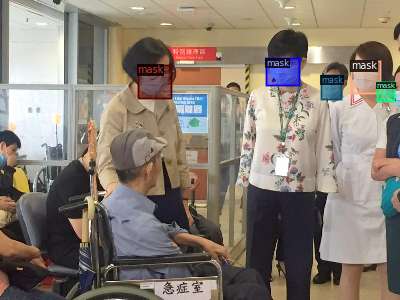

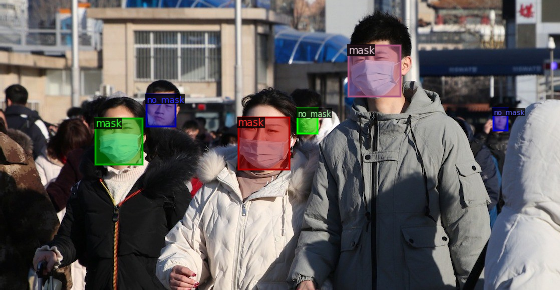

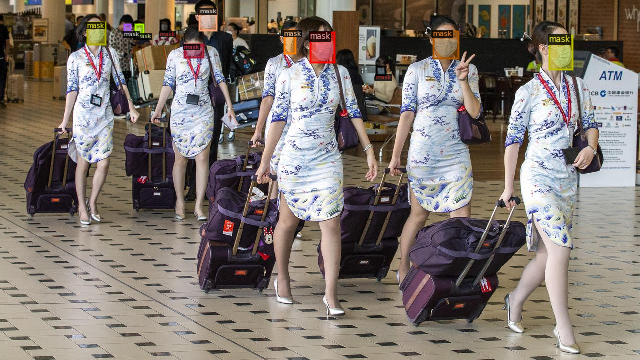

In [ ]:
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

#**V. Train**

In [ ]:
%cd /content/drive/MyDrive/CS117/RetinaNet

/content/drive/MyDrive/CS117/RetinaNet


In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/retinanet_R_50_FPN_3x.yaml"))

cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)
cfg.DATALOADER.NUM_WORKERS = 4
# cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/retinanet_R_50_FPN_3x.yaml")
cfg.MODEL.WEIGHTS = '/content/drive/MyDrive/CS117/RetinaNet/output/model_final.pth'
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.0001  # pick a good LR
cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 4800 
cfg.SOLVER.STEPS = []       
cfg.SOLVER.GAMMA = 0.05

cfg.MODEL.RETINANET.BATCH_SIZE_PER_IMAGE = 64   
cfg.MODEL.RETINANET.NUM_CLASSES = 2  
cfg.TEST.EVAL_PERIOD = 500

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

Loading config /usr/local/lib/python3.7/dist-packages/detectron2/model_zoo/configs/COCO-Detection/../Base-RetinaNet.yaml with yaml.unsafe_load. Your machine may be at risk if the file contains malicious content.


[08/29 02:15:18 d2.engine.defaults]: Model:
RetinaNet(
  (backbone): FPN(
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelP6P7(
      (p6): Conv2d(2048, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (p7): Conv2d(256, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    )
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res2)

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


[08/29 02:15:18 d2.engine.train_loop]: Starting training from iteration 0
[08/29 02:15:49 d2.utils.events]:  eta: 0:04:48  iter: 19  total_loss: 0.3242  loss_cls: 0.1073  loss_box_reg: 0.2219  time: 1.0324  data_time: 0.5627  lr: 6.427e-07  max_mem: 2481M
[08/29 02:16:00 d2.utils.events]:  eta: 0:03:40  iter: 39  total_loss: 0.2552  loss_cls: 0.07746  loss_box_reg: 0.1749  time: 0.7547  data_time: 0.0194  lr: 1.3087e-06  max_mem: 2659M
[08/29 02:16:08 d2.utils.events]:  eta: 0:01:54  iter: 59  total_loss: 0.353  loss_cls: 0.1286  loss_box_reg: 0.1884  time: 0.6410  data_time: 0.0073  lr: 1.9747e-06  max_mem: 2659M
[08/29 02:16:18 d2.utils.events]:  eta: 0:01:43  iter: 79  total_loss: 0.2486  loss_cls: 0.0774  loss_box_reg: 0.1716  time: 0.5977  data_time: 0.0226  lr: 2.6407e-06  max_mem: 2659M
[08/29 02:16:26 d2.utils.events]:  eta: 0:01:30  iter: 99  total_loss: 0.2958  loss_cls: 0.09959  loss_box_reg: 0.196  time: 0.5609  data_time: 0.0064  lr: 3.3067e-06  max_mem: 2659M
[08/29 02:16

#**VI. Evaluation**

In [ ]:
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset


# cfg = get_cfg()
# # cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/retinanet_R_50_FPN_3x.yaml"))

# cfg.DATASETS.TRAIN = ("my_dataset_train",)
# cfg.DATASETS.TEST = ("my_dataset_val",)
# trainer = DefaultTrainer(cfg)


cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.RETINANET.SCORE_THRESH_TEST = 0.5
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_val", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_val")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [08/29 02:18:08 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [08/29 02:18:09 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[08/29 02:18:09 d2.data.datasets.coco]: Loaded 100 images in COCO format from /content/drive/MyDrive/CS117/RetinaNet/val_dicts.json
[08/29 02:18:09 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[08/29 02:18:09 d2.data.common]: Serializing 100 elements to byte tensors and concatenating them all ...
[08/29 02:18:09 d2.data.common]: Serialized dataset takes 0.07 MiB
[08/29 02:18:09 d2.evaluation.evaluator]: Start inference on 100 batches


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


[08/29 02:18:11 d2.evaluation.evaluator]: Inference done 11/100. Dataloading: 0.0020 s/iter. Inference: 0.1055 s/iter. Eval: 0.0003 s/iter. Total: 0.1079 s/iter. ETA=0:00:09
[08/29 02:18:16 d2.evaluation.evaluator]: Inference done 59/100. Dataloading: 0.0031 s/iter. Inference: 0.1020 s/iter. Eval: 0.0003 s/iter. Total: 0.1055 s/iter. ETA=0:00:04
[08/29 02:18:20 d2.evaluation.evaluator]: Total inference time: 0:00:10.261652 (0.108017 s / iter per device, on 1 devices)
[08/29 02:18:20 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:09 (0.102216 s / iter per device, on 1 devices)
[08/29 02:18:20 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[08/29 02:18:20 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[08/29 02:18:20 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.01s)
creating index...
index created!
[08/29 02:18:20 d2.evaluation

OrderedDict([('bbox',
              {'AP': 46.97278325138239,
               'AP-mask': 57.2554153097151,
               'AP-no_mask': 36.69015119304968,
               'AP50': 82.5407485529455,
               'AP75': 47.57089492292524,
               'APl': 60.79166380191542,
               'APm': 47.88177263490683,
               'APs': 22.352680667379683})])

In [ ]:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.RETINANET.SCORE_THRESH_TEST = 0.5
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
test_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, test_loader, evaluator)

WARNING [08/29 02:21:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [08/29 02:21:16 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[08/29 02:21:16 d2.data.datasets.coco]: Loaded 120 images in COCO format from /content/drive/MyDrive/CS117/RetinaNet/test_dicts.json
[08/29 02:21:16 d2.data.build]: Distribution of instances among all 2 categories:
|  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|
|  no_mask   | 154          |    mask    | 475          |
|            |              |            |              |
|   total    | 629          |            |              |
[08/29 02:21:16 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[08/29 0

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


[08/29 02:21:18 d2.evaluation.evaluator]: Inference done 11/120. Dataloading: 0.0140 s/iter. Inference: 0.0985 s/iter. Eval: 0.0007 s/iter. Total: 0.1132 s/iter. ETA=0:00:12
[08/29 02:21:23 d2.evaluation.evaluator]: Inference done 50/120. Dataloading: 0.0236 s/iter. Inference: 0.0981 s/iter. Eval: 0.0063 s/iter. Total: 0.1281 s/iter. ETA=0:00:08
[08/29 02:21:28 d2.evaluation.evaluator]: Inference done 89/120. Dataloading: 0.0266 s/iter. Inference: 0.0980 s/iter. Eval: 0.0035 s/iter. Total: 0.1283 s/iter. ETA=0:00:03
[08/29 02:21:33 d2.evaluation.evaluator]: Total inference time: 0:00:15.453451 (0.134378 s / iter per device, on 1 devices)
[08/29 02:21:33 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:11 (0.098178 s / iter per device, on 1 devices)
[08/29 02:21:33 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[08/29 02:21:33 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[08/29 02:21:33 d2.evaluation.coco_

OrderedDict([('bbox',
              {'AP': 48.92663767004877,
               'AP-mask': 60.51832065762809,
               'AP-no_mask': 37.334954682469444,
               'AP50': 83.24154277126051,
               'AP75': 53.411517643225494,
               'APl': 61.07063163482379,
               'APm': 51.818119143019636,
               'APs': 38.54201914845387})])

#**VII. Predict Image**

In [ ]:
%cd /content/drive/MyDrive/CS117/RetinaNet

/content/drive/MyDrive/CS117/RetinaNet


In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.RETINANET.SCORE_THRESH_TEST = 0.5   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

WARNING [08/29 02:23:20 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[08/29 02:23:20 d2.data.datasets.coco]: Loaded 120 images in COCO format from /content/drive/MyDrive/CS117/RetinaNet/test_dicts.json
{'file_name': '/content/drive/MyDrive/CS117/Yolo/darknet/data/data/test/stsciRq.png', 'height': 1717, 'width': 828, 'image_id': 99, 'annotations': [{'iscrowd': 0, 'bbox': [248.0, 613.0, 286.0, 300.0000000000001], 'category_id': 1, 'segmentation': [[248.0, 613.0, 534.0, 613.0, 534.0, 913.0000000000001, 248.0, 913.0000000000001]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': 0, 'bbox': [349.0, 1414.0000000000002, 152.99999999999994, 155.99999999999977], 'category_id': 1, 'segmentation': [[349.0, 1414.0000000000002, 501.99999999999994, 1414.0000000000002, 501.99999999999994, 1570.0, 349.0, 1570.0]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}]}
time:  0.18144750595092773


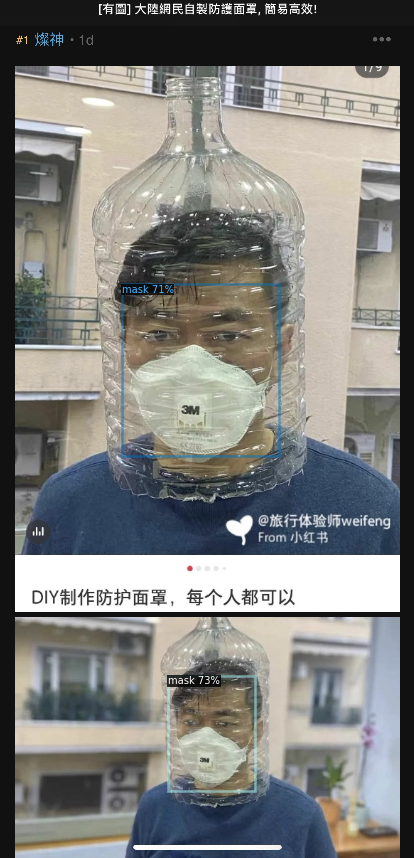

Instances(num_instances=2, image_height=1717, image_width=828, fields=[pred_boxes: Boxes(tensor([[ 336.1179, 1352.6146,  510.0130, 1583.4009],
        [ 243.1518,  569.6971,  558.0822,  913.2847]])), scores: tensor([0.7292, 0.7125]), pred_classes: tensor([1, 1])])
{'file_name': '/content/drive/MyDrive/CS117/Yolo/darknet/data/data/test/shutterstock_584407723.jpg', 'height': 667, 'width': 1000, 'image_id': 82, 'annotations': [{'iscrowd': 0, 'bbox': [330.99999999999994, 202.99999999999997, 60.00000000000006, 66.00000000000003], 'category_id': 1, 'segmentation': [[330.99999999999994, 202.99999999999997, 391.0, 202.99999999999997, 391.0, 269.0, 330.99999999999994, 269.0]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': 0, 'bbox': [540.0, 188.0, 65.0, 68.0], 'category_id': 1, 'segmentation': [[540.0, 188.0, 605.0, 188.0, 605.0, 256.0, 540.0, 256.0]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': 0, 'bbox': [803.0, 152.99999999999997, 47.0, 51.00000000000003], 'category_id': 1, 'segmenta

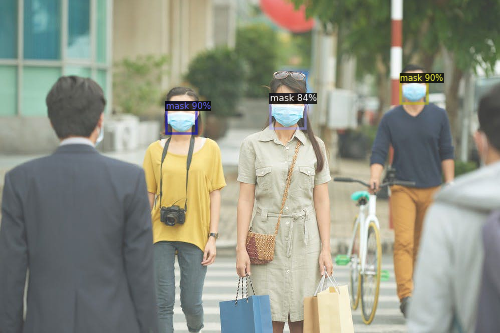

Instances(num_instances=3, image_height=667, image_width=1000, fields=[pred_boxes: Boxes(tensor([[800.4988, 148.3638, 854.0599, 207.7305],
        [331.2747, 204.3782, 392.5594, 267.4896],
        [539.0721, 188.5935, 609.0143, 256.7196]])), scores: tensor([0.8986, 0.8959, 0.8383]), pred_classes: tensor([1, 1, 1])])
{'file_name': '/content/drive/MyDrive/CS117/Yolo/darknet/data/data/test/nz_srilanka_280120.jpg', 'height': 853, 'width': 1280, 'image_id': 44, 'annotations': [{'iscrowd': 0, 'bbox': [423.00000000000006, 341.0, 45.99999999999994, 52.0], 'category_id': 1, 'segmentation': [[423.00000000000006, 341.0, 469.0, 341.0, 469.0, 393.0, 423.00000000000006, 393.0]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': 0, 'bbox': [645.0000000000001, 371.0, 36.999999999999886, 45.0], 'category_id': 1, 'segmentation': [[645.0000000000001, 371.0, 682.0, 371.0, 682.0, 416.0, 645.0000000000001, 416.0]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': 0, 'bbox': [937.0, 364.0, 43.000000000000114,

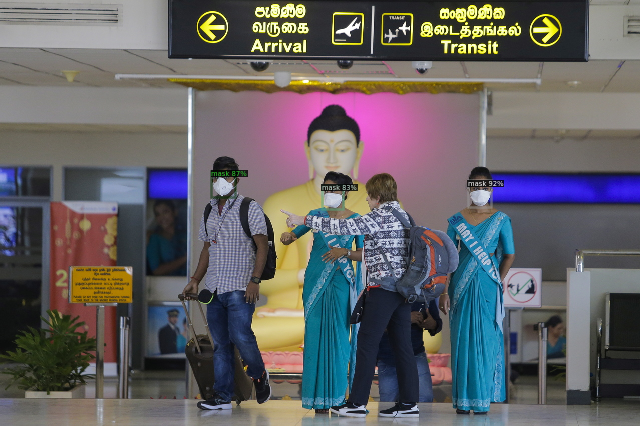

Instances(num_instances=3, image_height=853, image_width=1280, fields=[pred_boxes: Boxes(tensor([[935.6586, 361.7565, 981.5611, 414.8039],
        [422.7457, 342.2231, 470.4844, 395.1845],
        [644.0814, 370.4543, 686.1944, 419.0224]])), scores: tensor([0.9213, 0.8674, 0.8286]), pred_classes: tensor([1, 1, 1])])
{'file_name': '/content/drive/MyDrive/CS117/Yolo/darknet/data/data/test/so(19).jpg', 'height': 1067, 'width': 1600, 'image_id': 106, 'annotations': [{'iscrowd': 0, 'bbox': [321.0, 431.00000000000006, 92.0, 118.00000000000006], 'category_id': 1, 'segmentation': [[321.0, 431.00000000000006, 413.0, 431.00000000000006, 413.0, 549.0000000000001, 321.0, 549.0000000000001]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': 0, 'bbox': [724.0, 274.00000000000006, 68.0, 126.99999999999994], 'category_id': 1, 'segmentation': [[724.0, 274.00000000000006, 792.0, 274.00000000000006, 792.0, 401.0, 724.0, 401.0]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': 0, 'bbox': [1300.0, 485.0, 

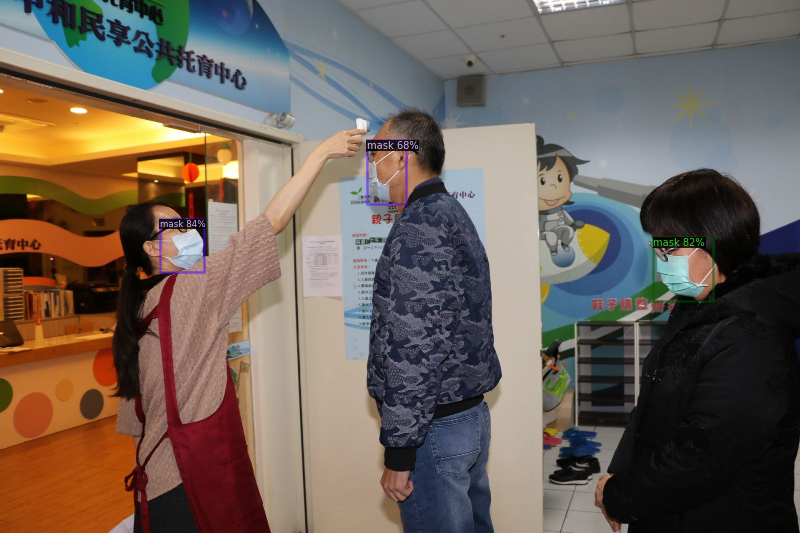

Instances(num_instances=3, image_height=1067, image_width=1600, fields=[pred_boxes: Boxes(tensor([[ 319.7114,  439.9409,  407.2902,  544.5012],
        [1306.8756,  475.5434, 1425.5757,  602.4686],
        [ 734.0927,  281.7509,  811.3237,  409.2777]])), scores: tensor([0.8368, 0.8247, 0.6785]), pred_classes: tensor([1, 1, 1])])
{'file_name': '/content/drive/MyDrive/CS117/Yolo/darknet/data/data/test/photo_0001_2020-02-04_F4IA3IB100AN0001NOS.jpg', 'height': 683, 'width': 1024, 'image_id': 69, 'annotations': [{'iscrowd': 0, 'bbox': [32.0, 219.0, 54.0, 54.0], 'category_id': 1, 'segmentation': [[32.0, 219.0, 86.0, 219.0, 86.0, 273.0, 32.0, 273.0]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': 0, 'bbox': [98.0, 233.99999999999997, 67.0, 66.00000000000003], 'category_id': 1, 'segmentation': [[98.0, 233.99999999999997, 165.0, 233.99999999999997, 165.0, 300.0, 98.0, 300.0]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': 0, 'bbox': [249.0, 248.0, 47.0, 49.0], 'category_id': 1, 'segmentat

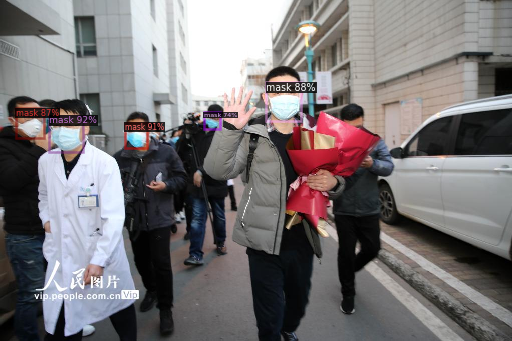

Instances(num_instances=5, image_height=683, image_width=1024, fields=[pred_boxes: Boxes(tensor([[ 98.4794, 232.5636, 165.0578, 304.6944],
        [249.8855, 246.5786, 294.6478, 297.4088],
        [532.9854, 165.3825, 601.5544, 243.1352],
        [ 31.5397, 217.7267,  88.0931, 277.8370],
        [408.0749, 225.5248, 440.2127, 259.8809]])), scores: tensor([0.9187, 0.9114, 0.8803, 0.8703, 0.7369]), pred_classes: tensor([1, 1, 1, 1, 1])])
{'file_name': '/content/drive/MyDrive/CS117/Yolo/darknet/data/data/test/p41000n445r5595258q.jpg', 'height': 899, 'width': 600, 'image_id': 23, 'annotations': [{'iscrowd': 0, 'bbox': [204.00000000000003, 168.00000000000003, 170.99999999999997, 192.99999999999997], 'category_id': 1, 'segmentation': [[204.00000000000003, 168.00000000000003, 375.0, 168.00000000000003, 375.0, 361.0, 204.00000000000003, 361.0]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}]}
time:  0.13804960250854492


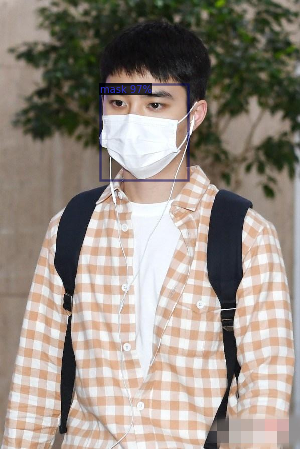

Instances(num_instances=1, image_height=899, image_width=600, fields=[pred_boxes: Boxes(tensor([[199.2725, 169.3018, 375.5348, 360.9664]])), scores: tensor([0.9729]), pred_classes: tensor([1])])
{'file_name': '/content/drive/MyDrive/CS117/Yolo/darknet/data/data/test/us-state-department-warns-against-visiting-china-citing-coronavirus.jpg', 'height': 783, 'width': 1200, 'image_id': 111, 'annotations': [{'iscrowd': 0, 'bbox': [146.00000000000003, 239.00000000000003, 53.0, 49.00000000000003], 'category_id': 1, 'segmentation': [[146.00000000000003, 239.00000000000003, 199.00000000000003, 239.00000000000003, 199.00000000000003, 288.00000000000006, 146.00000000000003, 288.00000000000006]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': 0, 'bbox': [285.0, 139.0, 42.0, 45.0], 'category_id': 1, 'segmentation': [[285.0, 139.0, 327.0, 139.0, 327.0, 184.0, 285.0, 184.0]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': 0, 'bbox': [636.0, 168.00000000000003, 53.0, 59.99999999999997], 'category_id

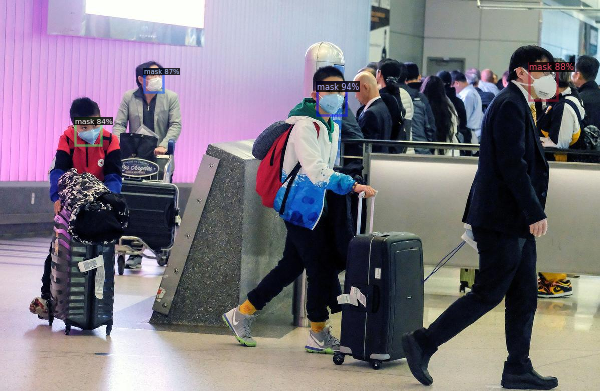

Instances(num_instances=4, image_height=783, image_width=1200, fields=[pred_boxes: Boxes(tensor([[ 633.7830,  165.0445,  691.3496,  231.0612],
        [1058.4117,  126.4920, 1114.7031,  201.0106],
        [ 287.9371,  138.4153,  326.7334,  185.6923],
        [ 149.3093,  237.4085,  202.5174,  290.9379]])), scores: tensor([0.9411, 0.8838, 0.8677, 0.8418]), pred_classes: tensor([1, 1, 1, 1])])
{'file_name': '/content/drive/MyDrive/CS117/Yolo/darknet/data/data/test/Pakistan-China-coronavirus-92news.jpg', 'height': 550, 'width': 900, 'image_id': 6, 'annotations': [{'iscrowd': 0, 'bbox': [27.000000000000004, 188.0, 32.0, 48.0], 'category_id': 1, 'segmentation': [[27.000000000000004, 188.0, 59.00000000000001, 188.0, 59.00000000000001, 236.0, 27.000000000000004, 236.0]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': 0, 'bbox': [98.0, 127.00000000000001, 36.0, 43.999999999999986], 'category_id': 1, 'segmentation': [[98.0, 127.00000000000001, 134.0, 127.00000000000001, 134.0, 171.0, 98.0, 17

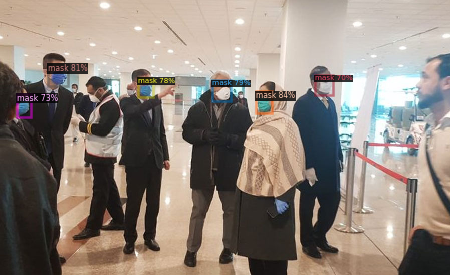

Instances(num_instances=6, image_height=550, image_width=900, fields=[pred_boxes: Boxes(tensor([[511.6240, 182.7897, 543.1191, 225.2957],
        [ 96.3146, 127.6845, 136.8304, 171.3008],
        [423.9322, 160.6056, 461.2141, 202.0232],
        [275.3057, 155.9686, 305.7612, 194.1358],
        [ 33.1562, 187.3687,  62.8833, 233.3780],
        [629.3370, 150.8847, 666.2130, 190.2566]])), scores: tensor([0.8356, 0.8078, 0.7868, 0.7810, 0.7314, 0.7004]), pred_classes: tensor([1, 1, 1, 1, 1, 1])])
{'file_name': '/content/drive/MyDrive/CS117/Yolo/darknet/data/data/test/thai.cov-transmission030220.jpg', 'height': 810, 'width': 1475, 'image_id': 109, 'annotations': [{'iscrowd': 0, 'bbox': [524.0000000000001, 159.0, 95.0, 107.0], 'category_id': 1, 'segmentation': [[524.0000000000001, 159.0, 619.0000000000001, 159.0, 619.0000000000001, 266.0, 524.0000000000001, 266.0]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': 0, 'bbox': [625.0, 133.99999999999997, 90.00000000000011, 104.00000000000003

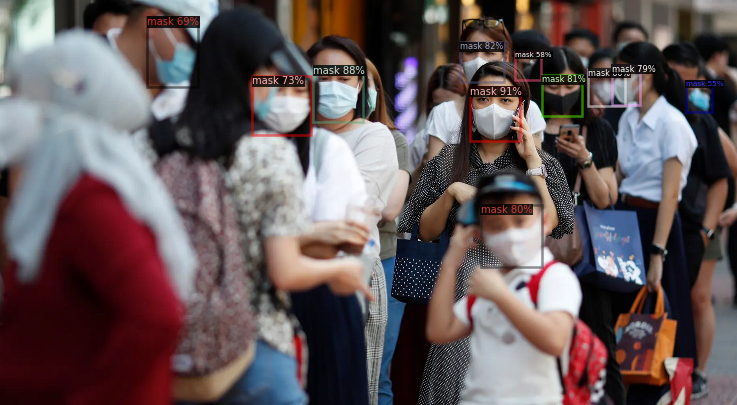

Instances(num_instances=11, image_height=810, image_width=1475, fields=[pred_boxes: Boxes(tensor([[ 939.4714,  173.3758, 1039.4930,  281.4991],
        [ 626.8734,  131.5185,  725.2625,  243.1590],
        [ 920.1976,   84.8642, 1007.1783,  163.0381],
        [1083.2809,  150.8791, 1163.6399,  232.0168],
        [ 961.0085,  409.2581, 1084.7062,  534.9961],
        [1223.4421,  129.6117, 1279.8701,  210.0089],
        [ 504.7582,  152.4936,  622.9673,  269.1577],
        [ 294.6242,   34.2976,  396.0961,  174.4469],
        [1176.5243,  137.2893, 1249.1163,  211.5996],
        [1030.8993,  103.9475, 1081.4486,  159.8618],
        [1371.0029,  162.0599, 1424.5892,  223.0263]])), scores: tensor([0.9073, 0.8752, 0.8222, 0.8128, 0.8033, 0.7941, 0.7301, 0.6935, 0.5983,
        0.5760, 0.5451]), pred_classes: tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])])
{'file_name': '/content/drive/MyDrive/CS117/Yolo/darknet/data/data/test/photo_l.jpg', 'height': 677, 'width': 960, 'image_id': 73, 'annotatio

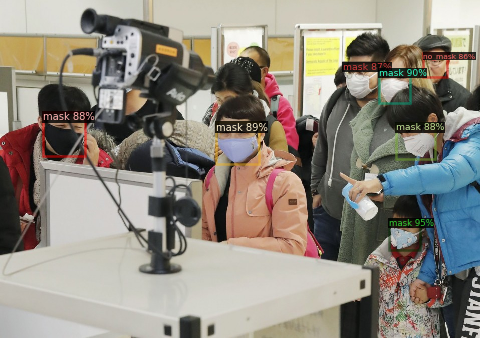

Instances(num_instances=7, image_height=677, image_width=960, fields=[pred_boxes: Boxes(tensor([[777.3456, 438.1348, 839.5287, 501.6875],
        [757.3142, 138.2702, 819.2705, 207.1089],
        [431.1885, 245.2766, 517.2512, 328.6438],
        [ 85.9957, 224.8241, 170.2660, 313.9172],
        [791.0447, 246.8941, 869.9822, 318.3734],
        [685.6797, 125.6869, 755.9448, 198.2169],
        [846.4596, 106.1804, 893.2125, 154.3288]])), scores: tensor([0.9516, 0.9021, 0.8947, 0.8779, 0.8761, 0.8685, 0.8554]), pred_classes: tensor([1, 1, 1, 1, 1, 1, 0])])
{'file_name': '/content/drive/MyDrive/CS117/Yolo/darknet/data/data/test/people-waiting-at-a-bus-stop-in-london-uk-AKBC3M.jpg', 'height': 956, 'width': 1300, 'image_id': 28, 'annotations': [{'iscrowd': 0, 'bbox': [365.0003499999999, 378.999986, 31.99950000000007, 45.999851999999976], 'category_id': 0, 'segmentation': [[365.0003499999999, 378.999986, 396.99985, 378.999986, 396.99985, 424.99983799999995, 365.0003499999999, 424.99983799999

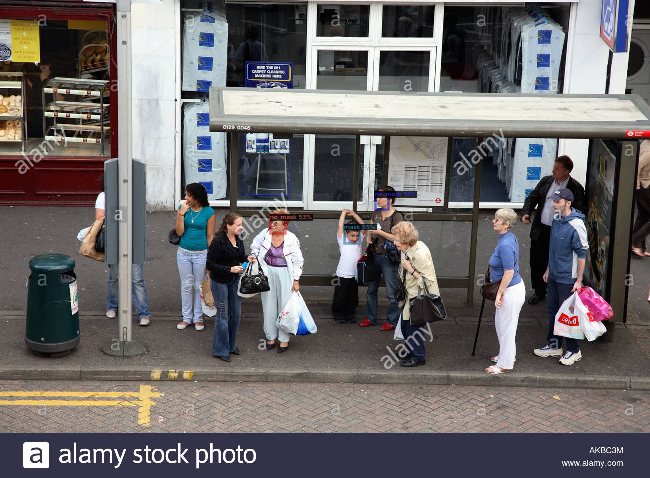

Instances(num_instances=3, image_height=956, image_width=1300, fields=[pred_boxes: Boxes(tensor([[688.7133, 449.1721, 718.9886, 485.1795],
        [540.5161, 428.9589, 570.8110, 465.9528],
        [749.3984, 383.2148, 776.7006, 418.1163]])), scores: tensor([0.5453, 0.5295, 0.5024]), pred_classes: tensor([1, 0, 0])])
{'file_name': '/content/drive/MyDrive/CS117/Yolo/darknet/data/data/test/three-people-sitting-at-a-covered-bus-stop-waiting-for-a-bus-B31DB4.jpg', 'height': 960, 'width': 1300, 'image_id': 102, 'annotations': [{'iscrowd': 0, 'bbox': [450.0002, 484.99968, 29.000400000000013, 31.000319999999988], 'category_id': 0, 'segmentation': [[450.0002, 484.99968, 479.0006, 484.99968, 479.0006, 516.0, 450.0002, 516.0]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': 0, 'bbox': [699.99995, 486.0, 20.000499999999988, 30.0], 'category_id': 0, 'segmentation': [[699.99995, 486.0, 720.00045, 486.0, 720.00045, 516.0, 699.99995, 516.0]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': 0, 'bbox

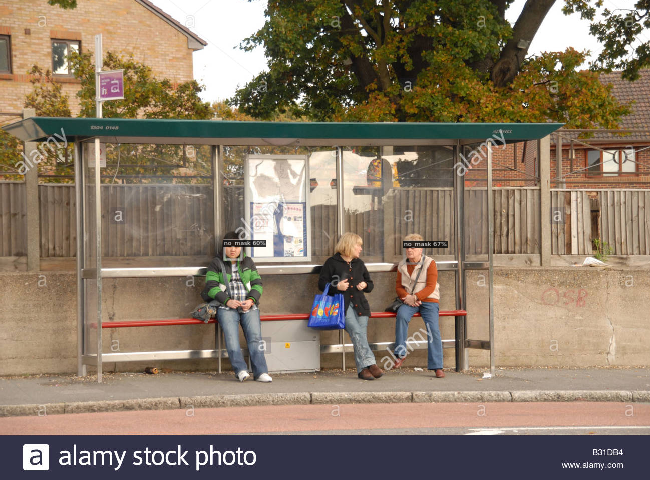

Instances(num_instances=2, image_height=960, image_width=1300, fields=[pred_boxes: Boxes(tensor([[808.1750, 482.6921, 845.4536, 525.9748],
        [447.9203, 480.9581, 482.7484, 518.2361]])), scores: tensor([0.6664, 0.6021]), pred_classes: tensor([0, 0])])
{'file_name': '/content/drive/MyDrive/CS117/Yolo/darknet/data/data/test/RTX1GIDS.jpg', 'height': 552, 'width': 937, 'image_id': 38, 'annotations': [{'iscrowd': 0, 'bbox': [0.0, 103.0, 41.0, 55.0], 'category_id': 0, 'segmentation': [[0.0, 103.0, 41.0, 103.0, 41.0, 158.0, 0.0, 158.0]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': 0, 'bbox': [206.00000000000006, 86.0, 60.0, 56.00000000000003], 'category_id': 1, 'segmentation': [[206.00000000000006, 86.0, 266.00000000000006, 86.0, 266.00000000000006, 142.00000000000003, 206.00000000000006, 142.00000000000003]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': 0, 'bbox': [374.0, 44.99999999999999, 80.0, 80.0], 'category_id': 0, 'segmentation': [[374.0, 44.99999999999999, 454.0, 44.999

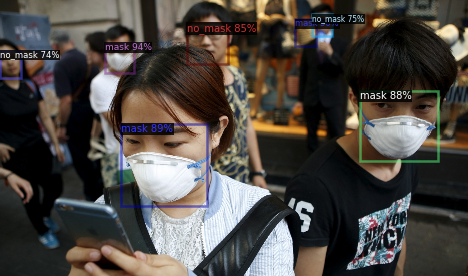

Instances(num_instances=7, image_height=552, image_width=937, fields=[pred_boxes: Boxes(tensor([[209.2601,  85.6953, 268.6603, 146.0402],
        [242.5536, 247.8017, 414.9327, 411.7432],
        [719.8779, 182.0160, 876.7431, 322.3347],
        [373.1693,  46.1233, 455.4568, 127.1833],
        [624.3399,  28.3851, 663.1165,  71.6417],
        [  0.0000, 101.1029,  42.2678, 155.0617],
        [590.6363,  38.4015, 632.2484,  91.8200]])), scores: tensor([0.9388, 0.8889, 0.8762, 0.8537, 0.7516, 0.7439, 0.5022]), pred_classes: tensor([1, 1, 1, 0, 0, 0, 1])])
{'file_name': '/content/drive/MyDrive/CS117/Yolo/darknet/data/data/test/US-expands-coronavirus-screenings-United-suspends-some-flights-to-China.jpg', 'height': 650, 'width': 975, 'image_id': 58, 'annotations': [{'iscrowd': 0, 'bbox': [283.0, 115.00000000000003, 121.99999999999994, 120.99999999999997], 'category_id': 0, 'segmentation': [[283.0, 115.00000000000003, 404.99999999999994, 115.00000000000003, 404.99999999999994, 236.0, 283.0,

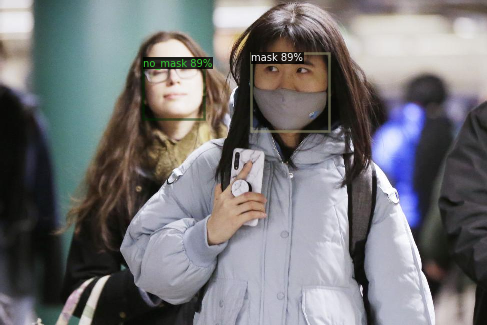

Instances(num_instances=2, image_height=650, image_width=975, fields=[pred_boxes: Boxes(tensor([[502.7656, 106.0122, 657.0424, 262.2487],
        [286.9310, 115.5390, 407.9423, 237.9119]])), scores: tensor([0.8941, 0.8921]), pred_classes: tensor([1, 0])])
{'file_name': '/content/drive/MyDrive/CS117/Yolo/darknet/data/data/test/photo (1).jpeg', 'height': 589, 'width': 1048, 'image_id': 72, 'annotations': []}
time:  0.1288442611694336


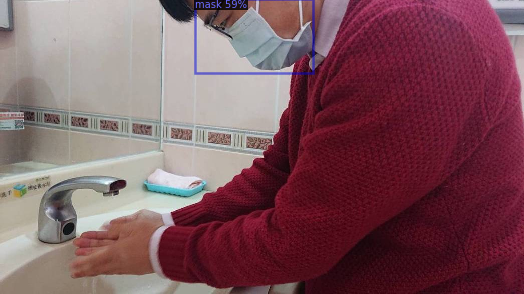

Instances(num_instances=1, image_height=589, image_width=1048, fields=[pred_boxes: Boxes(tensor([[390.1737,   0.0000, 625.4423, 146.4907]])), scores: tensor([0.5859]), pred_classes: tensor([1])])
{'file_name': '/content/drive/MyDrive/CS117/Yolo/darknet/data/data/test/three-ordinary-mexican-people-mexicans-waiting-for-bus-at-bus-stop-CPAECA.jpg', 'height': 956, 'width': 1300, 'image_id': 108, 'annotations': [{'iscrowd': 0, 'bbox': [574.00005, 394.99960200000004, 25.00030000000004, 34.00013999999993], 'category_id': 0, 'segmentation': [[574.00005, 394.99960200000004, 599.00035, 394.99960200000004, 599.00035, 428.99974199999997, 574.00005, 428.99974199999997]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': 0, 'bbox': [56.9998, 422.999886, 22.999600000000008, 30.000235999999973], 'category_id': 0, 'segmentation': [[56.9998, 422.999886, 79.99940000000001, 422.999886, 79.99940000000001, 453.000122, 56.9998, 453.000122]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': 0, 'bbox': [9.99960

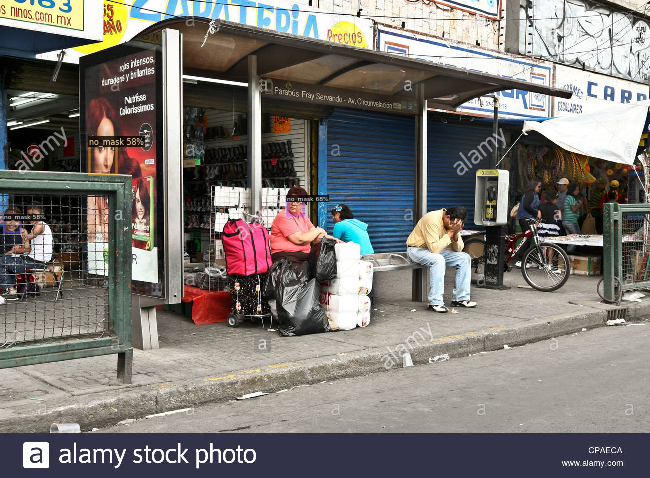

Instances(num_instances=3, image_height=956, image_width=1300, fields=[pred_boxes: Boxes(tensor([[573.1852, 391.8913, 605.6462, 429.6314],
        [178.1844, 274.1323, 231.8374, 348.1132],
        [  8.7399, 428.7429,  40.4649, 464.6829]])), scores: tensor([0.6841, 0.5845, 0.5828]), pred_classes: tensor([0, 0, 0])])
{'file_name': '/content/drive/MyDrive/CS117/Yolo/darknet/data/data/test/sdsdsff.jpg', 'height': 340, 'width': 512, 'image_id': 30, 'annotations': [{'iscrowd': 0, 'bbox': [13.0, 94.0, 31.0, 36.0], 'category_id': 1, 'segmentation': [[13.0, 94.0, 44.0, 94.0, 44.0, 130.0, 13.0, 130.0]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': 0, 'bbox': [115.0, 92.0, 31.0, 32.999999999999986], 'category_id': 1, 'segmentation': [[115.0, 92.0, 146.0, 92.0, 146.0, 124.99999999999999, 115.0, 124.99999999999999]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': 0, 'bbox': [209.0, 103.99999999999999, 31.0, 32.000000000000014], 'category_id': 1, 'segmentation': [[209.0, 103.99999999999999, 2

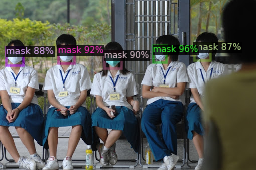

Instances(num_instances=5, image_height=340, image_width=512, fields=[pred_boxes: Boxes(tensor([[306.4107,  90.7084, 331.3441, 123.1539],
        [115.3224,  91.8735, 148.6452, 125.3438],
        [208.6852, 102.1538, 241.2100, 135.0836],
        [ 12.8013,  93.9810,  46.3993, 129.5657],
        [388.4033,  85.9372, 419.1801, 120.7415]])), scores: tensor([0.9615, 0.9190, 0.8992, 0.8802, 0.8684]), pred_classes: tensor([1, 1, 1, 1, 1])])
{'file_name': '/content/drive/MyDrive/CS117/Yolo/darknet/data/data/test/photo (4).jpeg', 'height': 960, 'width': 720, 'image_id': 13, 'annotations': []}
time:  0.12063288688659668


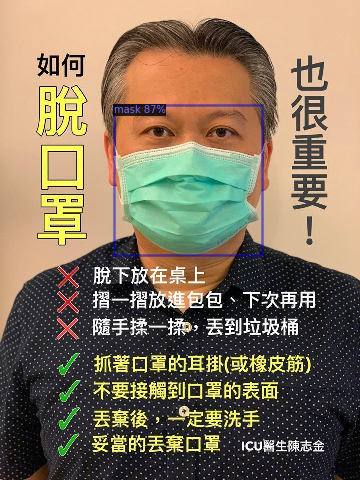

Instances(num_instances=1, image_height=960, image_width=720, fields=[pred_boxes: Boxes(tensor([[227.0288, 209.7003, 524.6426, 509.1574]])), scores: tensor([0.8678]), pred_classes: tensor([1])])
{'file_name': '/content/drive/MyDrive/CS117/Yolo/darknet/data/data/test/pjecDNMmCUQmbDoJx1fdqolnfHtpsfFK8jTA2Ng0wNg.jpeg', 'height': 1280, 'width': 1920, 'image_id': 29, 'annotations': [{'iscrowd': 0, 'bbox': [214.0, 327.0, 133.0, 132.00000000000006], 'category_id': 1, 'segmentation': [[214.0, 327.0, 347.0, 327.0, 347.0, 459.00000000000006, 214.0, 459.00000000000006]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': 0, 'bbox': [521.0, 378.00000000000006, 119.00000000000011, 142.00000000000006], 'category_id': 1, 'segmentation': [[521.0, 378.00000000000006, 640.0000000000001, 378.00000000000006, 640.0000000000001, 520.0000000000001, 521.0, 520.0000000000001]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': 0, 'bbox': [782.0, 304.0, 162.0, 171.0], 'category_id': 1, 'segmentation': [[782.0, 304

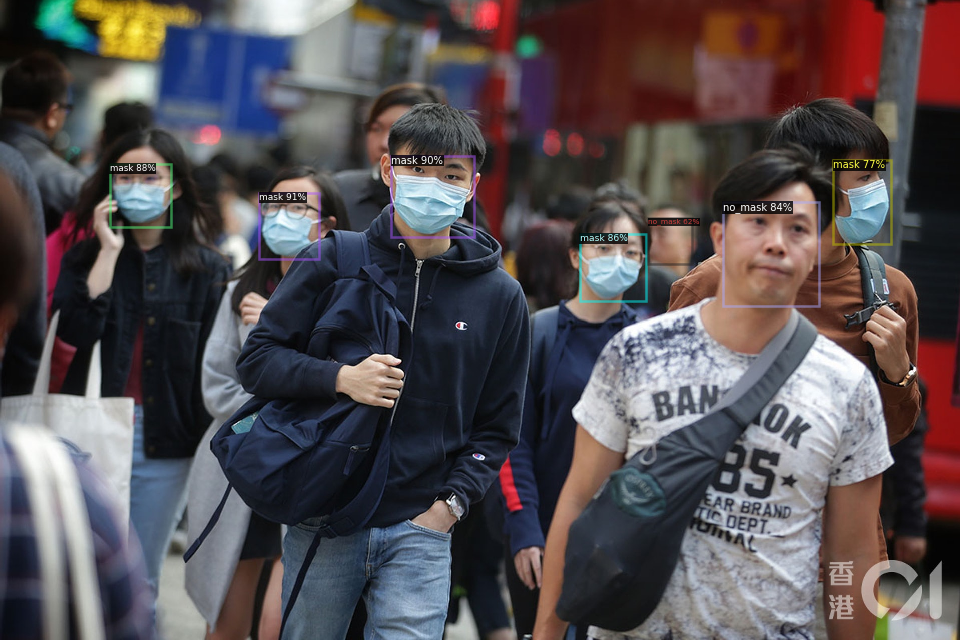

Instances(num_instances=7, image_height=1280, image_width=1920, fields=[pred_boxes: Boxes(tensor([[ 518.7196,  386.2370,  637.5792,  517.8229],
        [ 782.5752,  311.5436,  947.6727,  474.8275],
        [ 220.0316,  327.7278,  341.1068,  453.3728],
        [1159.2333,  468.3916, 1291.2206,  602.6519],
        [1445.4637,  404.3135, 1638.1134,  611.5031],
        [1666.5488,  320.5014, 1781.0739,  488.7051],
        [1296.6331,  436.3963, 1383.0764,  527.8345]])), scores: tensor([0.9052, 0.9037, 0.8837, 0.8577, 0.8431, 0.7667, 0.6158]), pred_classes: tensor([1, 1, 1, 1, 0, 1, 0])])
{'file_name': '/content/drive/MyDrive/CS117/Yolo/darknet/data/data/test/people-waiting-for-bus-at-a-bus-stop-porto-portugal-europe-C7BJEE.jpg', 'height': 955, 'width': 1300, 'image_id': 75, 'annotations': [{'iscrowd': 0, 'bbox': [1000.0003, 357.9994175, 34.00020000000006, 47.00032500000003], 'category_id': 0, 'segmentation': [[1000.0003, 357.9994175, 1034.0005, 357.9994175, 1034.0005, 404.9997425, 1000.000

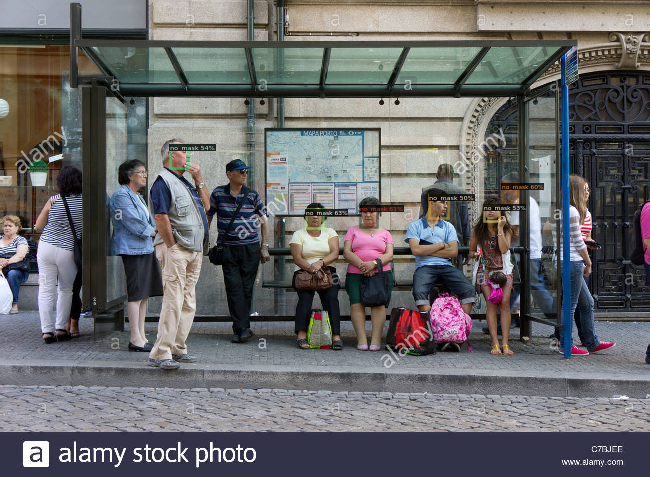

Instances(num_instances=6, image_height=955, image_width=1300, fields=[pred_boxes: Boxes(tensor([[ 611.8055,  419.8791,  646.8575,  456.3193],
        [ 720.3943,  411.6409,  754.6202,  454.6884],
        [1004.0068,  367.7666, 1036.4708,  406.1969],
        [ 340.3068,  289.7639,  376.4687,  337.6238],
        [ 967.4270,  410.1270,  998.5210,  443.8567],
        [ 858.3969,  390.4666,  896.7260,  437.5462]])), scores: tensor([0.6295, 0.6145, 0.6041, 0.5449, 0.5338, 0.5003]), pred_classes: tensor([0, 0, 0, 0, 0, 0])])


In [ ]:
from detectron2.utils.visualizer import ColorMode
import time
dataset_dicts = DatasetCatalog.get("my_dataset_test")
my_dataset_test_metadata = MetadataCatalog.get("my_dataset_test")
total_time=0
for d in random.sample(dataset_dicts, 20):    
    print(d)
    im = cv2.imread(d["file_name"])
    t0 = time.time()
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    t1 = time.time()
    print("time: ", t1-t0)
    total_time += (t1-t0)
    v = Visualizer(im[:, :, ::-1],
                  #  metadata=signs_metadata_val, 
                   metadata=my_dataset_test_metadata,
                   scale=0.5, 
                  # instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])
    print(outputs["instances"].to("cpu"))


In [ ]:
total_time / 20

0.13603821992874146

#**VIII. Predict Video**

In [ ]:
%cd /content/drive/MyDrive/CS117/RetinaNet

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.RETINANET.SCORE_THRESH_TEST = 0.5   # set a custom testing threshold
cfg.DATASETS.TEST = ("my_dataset_test", )
predictor = DefaultPredictor(cfg)

In [ ]:
import tqdm
from detectron2.utils.video_visualizer import VideoVisualizer
from detectron2.utils.visualizer import ColorMode, Visualizer
import time

In [ ]:
# Extract video properties
video = cv2.VideoCapture('/content/drive/MyDrive/CS114/Dien/video/video_test.mp4')
width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))
frames_per_second = video.get(cv2.CAP_PROP_FPS)
num_frames = int(video.get(cv2.CAP_PROP_FRAME_COUNT))

# Initialize video writer
video_writer = cv2.VideoWriter('video_night_train4_0dot5.mp4', fourcc=cv2.VideoWriter_fourcc(*"mp4v"), fps=float(frames_per_second), frameSize=(width, height), isColor=True)

# # Initialize predictor
# cfg = get_cfg()
# cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
# cfg.MODEL.RETINANET.SCORE_THRESH_TEST = 0.7  # set threshold for this model
# cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
# predictor = DefaultPredictor(cfg)



# Initialize visualizer
v = VideoVisualizer(MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), ColorMode.IMAGE)

def runOnVideo(video, maxFrames):
    """ Runs the predictor on every frame in the video (unless maxFrames is given),
    and returns the frame with the predictions drawn.
    """

    readFrames = 0
    while True:
        hasFrame, frame = video.read()
        if not hasFrame:
            break

        # Get prediction results for this frame
        outputs = predictor(frame)

        # Make sure the frame is colored
        frame = cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)

        # Draw a visualization of the predictions using the video visualizer
        visualization = v.draw_instance_predictions(frame, outputs["instances"].to("cpu"))

        # Convert Matplotlib RGB format to OpenCV BGR format
        visualization = cv2.cvtColor(visualization.get_image(), cv2.COLOR_RGB2BGR)

        yield visualization

        readFrames += 1
        if readFrames > maxFrames:
            break

# Create a cut-off for debugging
num_frames = 8000

# Enumerate the frames of the video
for visualization in tqdm.tqdm(runOnVideo(video, num_frames), total=num_frames):

    # Write test image
    cv2.imwrite('POSE detectron2.png', visualization)

    # Write to video file
    video_writer.write(visualization)

# Release resources
video.release()
video_writer.release()
cv2.destroyAllWindows()